In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from glob import glob
import seaborn as sns
import PIL

In [2]:
base_skin_dir = "/Users/dell6/OneDrive/Desktop/CODING_NEW/FACULTY PROJECT"
skin_df = pd.read_csv(os.path.join(base_skin_dir, 'HAM10000_metadata'))
skin_df.head()


,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,vidir_modern
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,vidir_modern
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,vidir_modern
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,vidir_modern
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,vidir_modern


In [3]:
imageid_path_dict = {os.path.splitext(os.path.basename(x))[0]: x
                     for x in glob(os.path.join(base_skin_dir, '*', '*.jpg'))}

lesion_type_dict = {
    'nv': 'Melanocytic_nevi',
    'mel': 'melanoma',
    'bkl': 'Benign_keratosis-like_lesions',
    'bcc': 'Basal_cell_carcinoma',
    'akiec': 'Actinic_keratoses',
    'vasc': 'Vascular_lesions',
    'df': 'Dermatofibroma'
}

lesion_danger = {
    'nv': 0, # 0 for benign
    'mel': 1, # 1 for malignant
    'bkl': 0, # 0 for benign
    'bcc': 1, # 1 for malignant
    'akiec': 1, # 1 for malignant
    'vasc': 0,
    'df': 0
}

In [4]:
skin_df["path"] = skin_df["image_id"].map(imageid_path_dict.get) # map image_id to the path of that image

In [5]:
skin_df["path"] = skin_df["image_id"].map(imageid_path_dict.get) # map image_id to the path of that image

In [6]:
skin_df["cell_type"] = skin_df["dx"].map(lesion_type_dict.get) # map dx to type of lesion

In [7]:
skin_df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset,path,cell_type
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions


In [8]:
skin_df["Malignant"] = skin_df["dx"].map(lesion_danger.get)

In [9]:
skin_df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset,path,cell_type,Malignant
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0


In [10]:
skin_df["cell_type_idx"] = pd.Categorical(skin_df["cell_type"]).codes # give each cell type a category id

In [11]:
skin_df.sample(3)

,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset,path,cell_type,Malignant,cell_type_idx
1630,HAM_0004593,ISIC_0024900,mel,histo,65.0,female,back,rosendahl,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,melanoma,1,6
8426,HAM_0000366,ISIC_0027147,nv,histo,75.0,male,back,rosendahl,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Melanocytic_nevi,0,4
3241,HAM_0006785,ISIC_0026169,nv,follow_up,45.0,male,back,vidir_molemax,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Melanocytic_nevi,0,4


<Axes: title={'center': 'Benign vs Malignant'}>

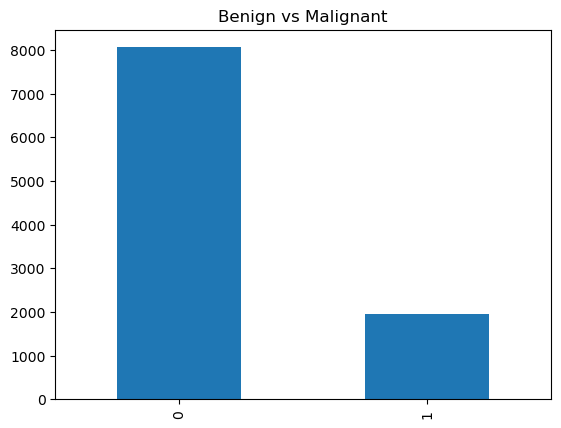

In [12]:
skin_df["Malignant"].value_counts().plot(kind="bar", title="Benign vs Malignant")

Most cases in our dataset are benign.

<Axes: title={'center': 'Counts for each type of Lesions'}>

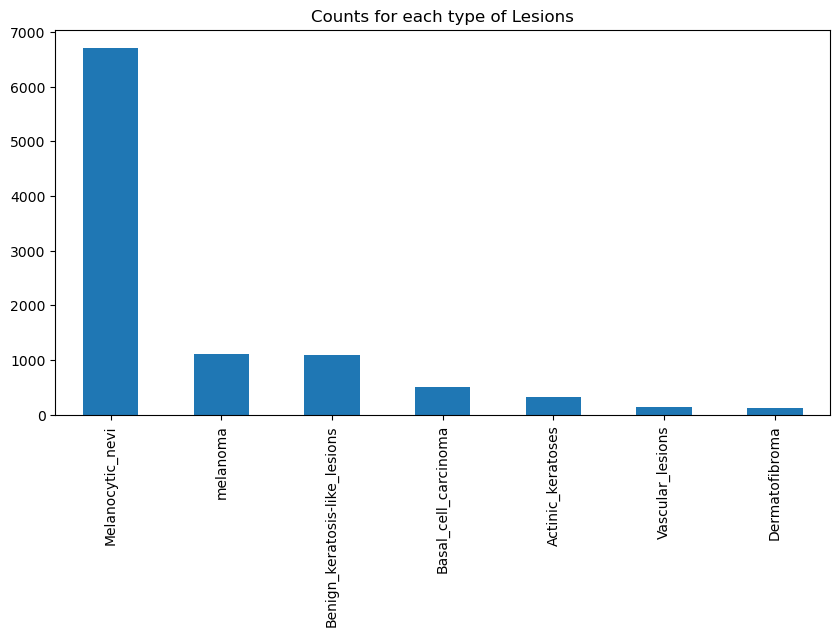

In [13]:
fig, ax1 = plt.subplots(1,1,figsize=(10,5))
skin_df["cell_type"].value_counts().plot(kind="bar", ax=ax1, title="Counts for each type of Lesions") # plot a graph counting the number of each cell type

<Axes: title={'center': 'Location of Lesions'}>

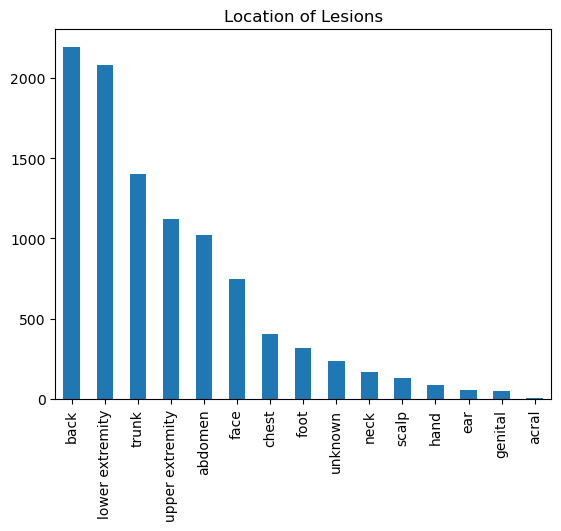

In [14]:
# let's see where lesions are mostly located
skin_df["localization"].value_counts().plot(kind='bar', title="Location of Lesions")

<Axes: title={'center': 'Treatment received'}>

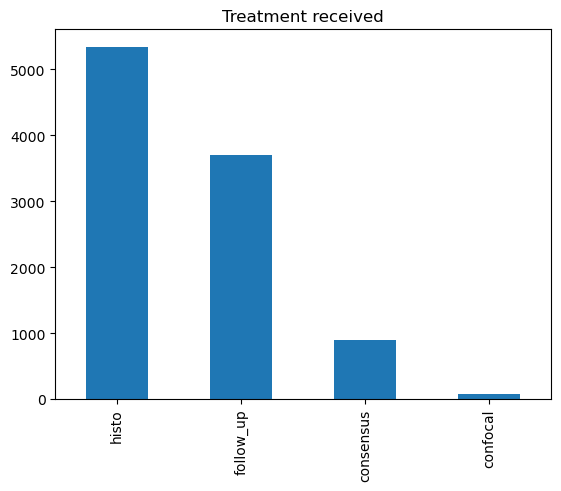

In [15]:
skin_df["dx_type"].value_counts().plot(kind='bar', title="Treatment received")

<Axes: >

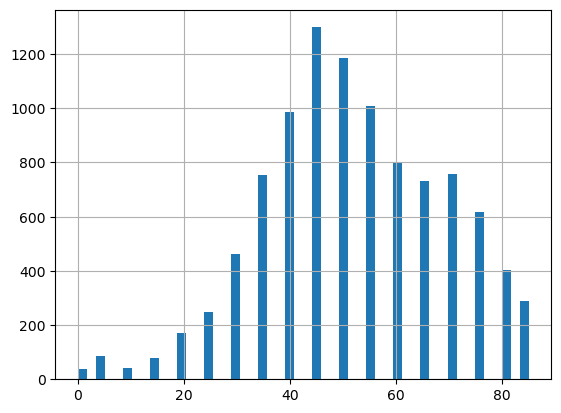

In [16]:
skin_df["age"].hist(bins=50)

<Axes: >

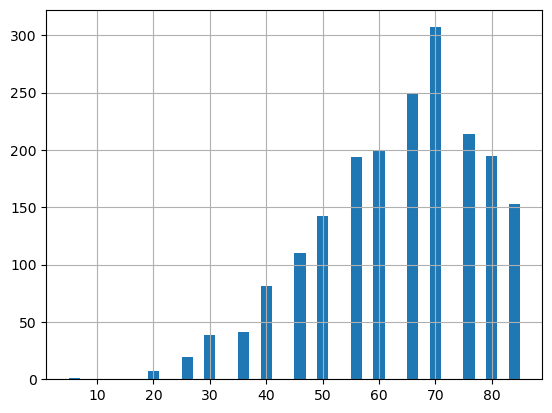

In [17]:
skin_df[skin_df["Malignant"] == 1]["age"].hist(bins=40)

<Axes: title={'center': 'Male vs Female'}>

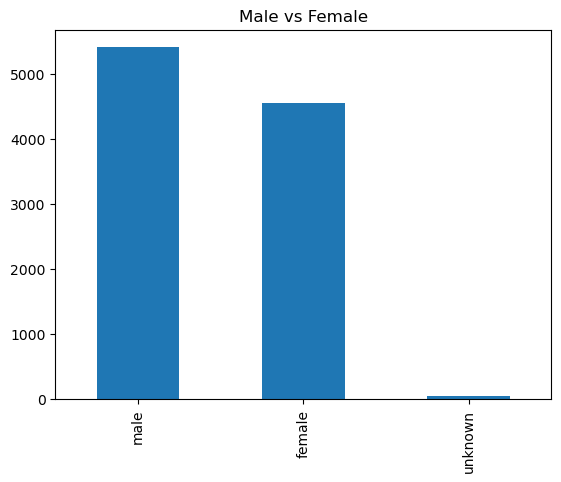

In [18]:
skin_df["sex"].value_counts().plot(kind="bar", title="Male vs Female")

<Axes: title={'center': 'Male vs Female. Malignant Cases'}>

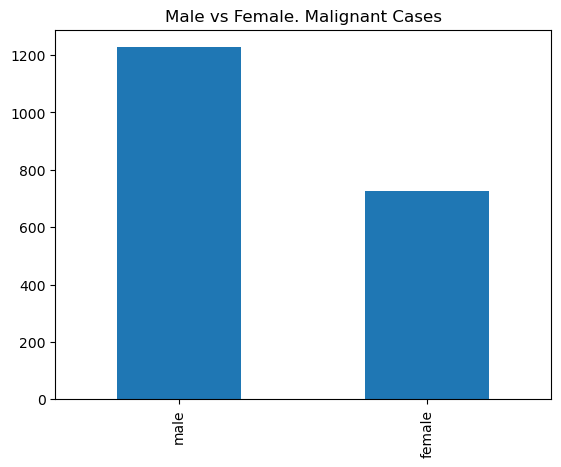

In [19]:
skin_df[skin_df["Malignant"] == 1]["sex"].value_counts().plot(kind="bar", title="Male vs Female. Malignant Cases")

In [20]:
from skimage.io import imread

In [21]:
skin_df

,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset,path,cell_type,Malignant,cell_type_idx
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0,2
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0,2
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0,2
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0,2
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Benign_keratosis-like_lesions,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Actinic_keratoses,1,0
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Actinic_keratoses,1,0
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Actinic_keratoses,1,0
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face,vidir_modern,/Users/dell6/OneDrive/Desktop/CODING_NEW/FACUL...,Actinic_keratoses,1,0


In [22]:
skin_df["image"] = skin_df["path"].map(imread) # read the image to array values

In [23]:
skin_df.iloc[0]["image"] # here is a sample

array([[[188, 147, 191],
        [186, 148, 189],
        [187, 150, 191],
        ...,
        [196, 155, 171],
        [197, 156, 170],
        [197, 157, 168]],

       [[186, 149, 193],
        [187, 152, 194],
        [189, 153, 191],
        ...,
        [194, 156, 169],
        [195, 159, 169],
        [192, 159, 168]],

       [[185, 148, 192],
        [189, 152, 195],
        [190, 153, 196],
        ...,
        [196, 155, 169],
        [198, 157, 171],
        [194, 156, 169]],

       ...,

       [[157, 124, 155],
        [156, 121, 154],
        [159, 124, 154],
        ...,
        [177, 146, 161],
        [176, 144, 159],
        [175, 141, 155]],

       [[155, 122, 151],
        [156, 123, 154],
        [156, 123, 152],
        ...,
        [178, 147, 163],
        [175, 144, 159],
        [175, 142, 159]],

       [[154, 119, 151],
        [153, 120, 149],
        [154, 121, 152],
        ...,
        [176, 147, 167],
        [175, 147, 161],
        [173, 143, 155]]

In [24]:
# let's see what is the shape of each value in the image column
skin_df["image"].map(lambda x: x.shape).value_counts() 

(450, 600, 3)    10015
Name: image, dtype: int64

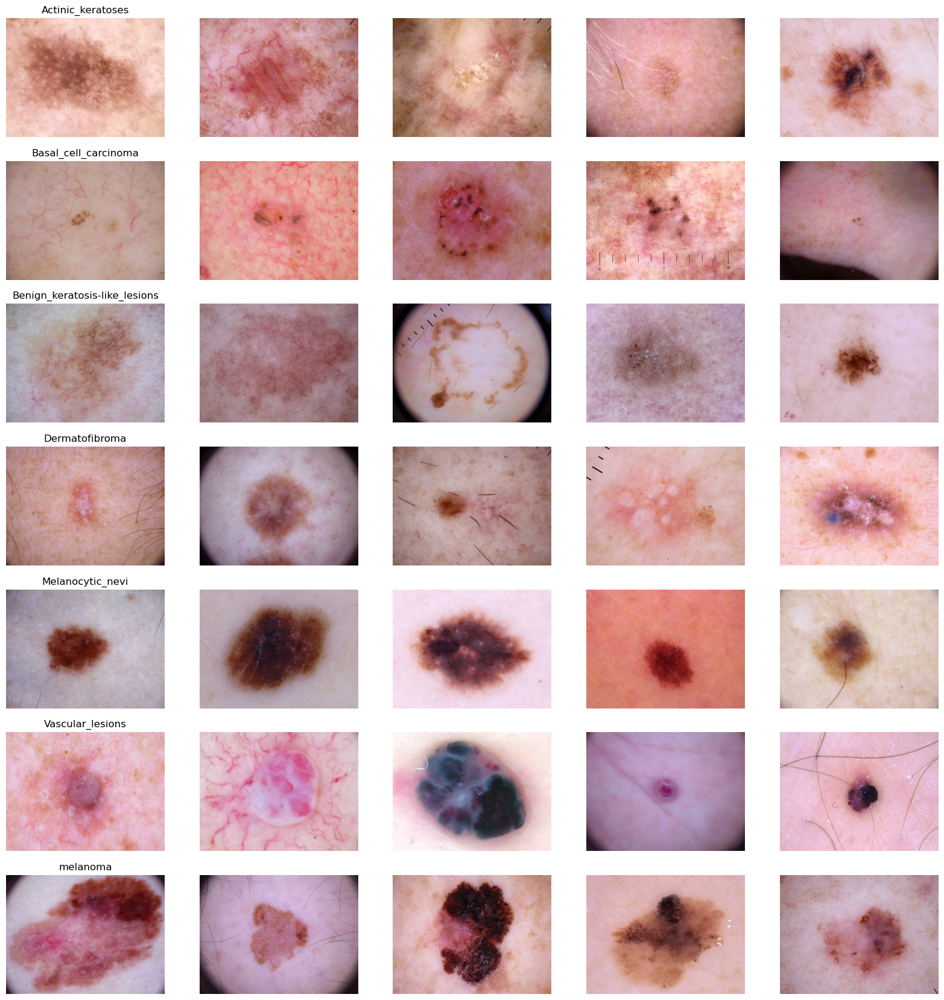

In [25]:
# let's have a look at the image data

n_samples = 5 # choose 5 samples for each cell type
fig, m_axs = plt.subplots(7, n_samples, figsize=(4*n_samples, 3 * 7))

for n_axs, (type_name, type_rows) in zip(m_axs, skin_df.sort_values(["cell_type"]).groupby("cell_type")):
    n_axs[0].set_title(type_name)
    for c_ax, (_, c_row) in zip(n_axs, type_rows.sample(n_samples, random_state=0).iterrows()):
        c_ax.imshow(c_row["image"])
        c_ax.axis("off")
fig.savefig("category_samples.png", dpi=300)

In [26]:
# Get Average Color Information
# create a pandas dataframe to store mean value of Red, Blue and Green for each picture

rgb_info_df = skin_df.apply(lambda x: pd.Series({'{}_mean'.format(k): v for k, v 
                                                 in zip(["Red", "Blue", "Green"], 
                                                        np.mean(x["image"], (0, 1)))}), 1)


gray_col_vec = rgb_info_df.apply(lambda x: np.mean(x), 1) # take the mean value across columns of rgb_info_df
for c_col in rgb_info_df.columns:
    rgb_info_df[c_col] = rgb_info_df[c_col]/gray_col_vec 
rgb_info_df["Gray_mean"] = gray_col_vec
rgb_info_df.sample(3)

,Red_mean,Blue_mean,Green_mean,Gray_mean
1239,1.070678,0.919475,1.009847,191.902452
3234,1.392051,0.775302,0.832647,157.376788
9411,1.096576,0.904800,0.998625,146.487751


In [27]:
for c_col in rgb_info_df.columns:
    skin_df[c_col] = rgb_info_df[c_col].values

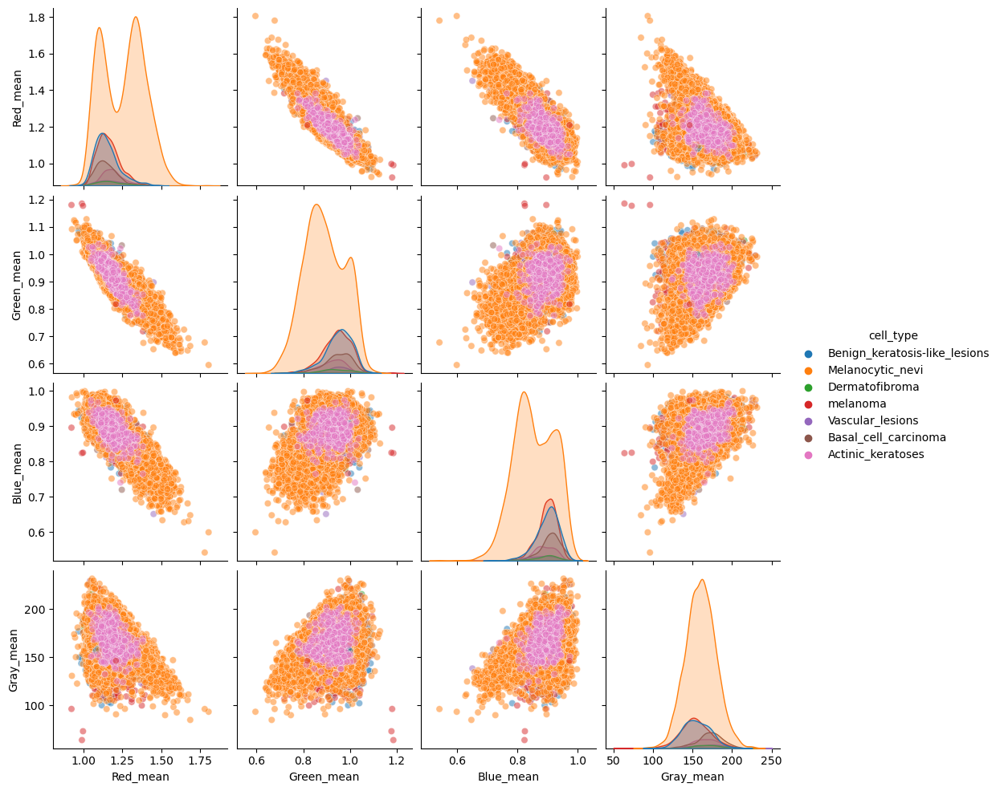

In [28]:
# let's draw a plot showing the distribution of different cell types over colors!
sns.pairplot(skin_df[["Red_mean", "Green_mean", "Blue_mean", "Gray_mean", "cell_type"]], 
             hue="cell_type", plot_kws = {"alpha": 0.5})

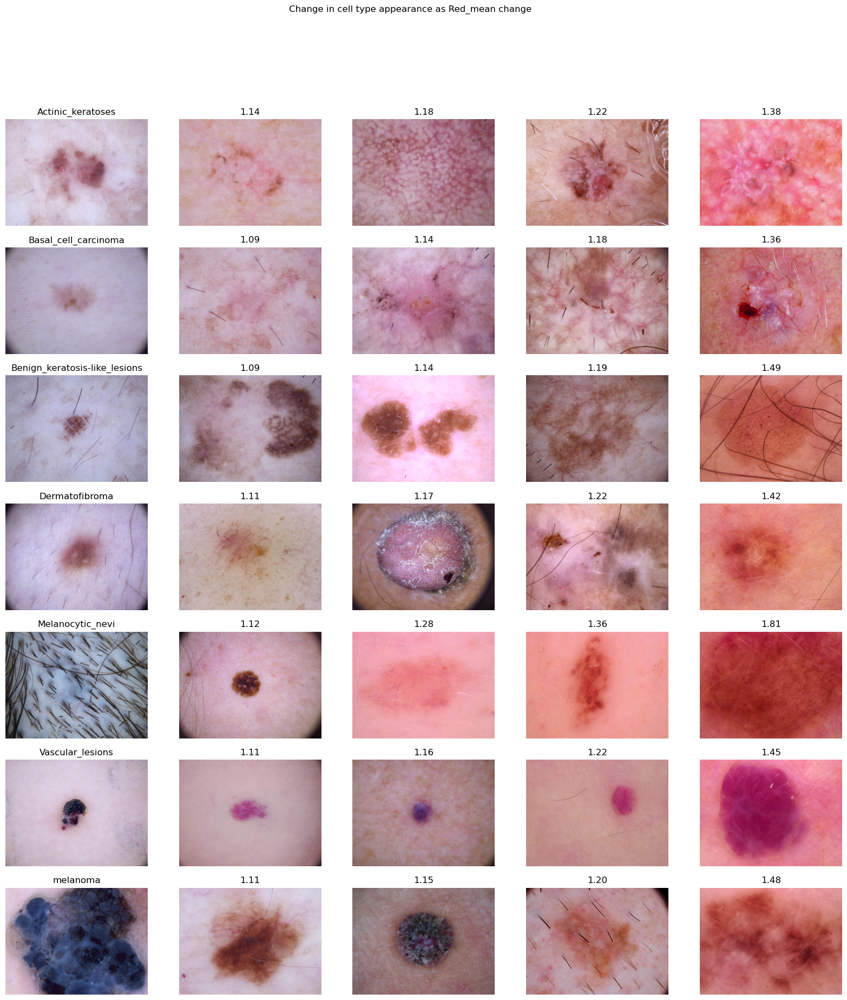

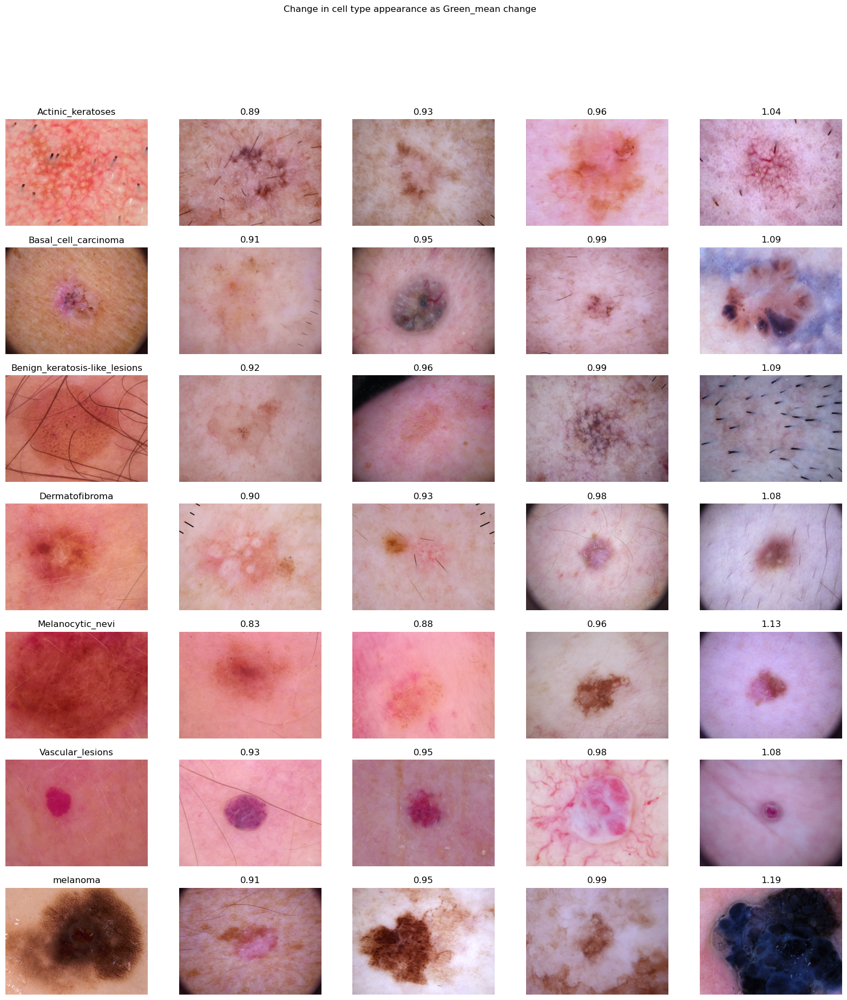

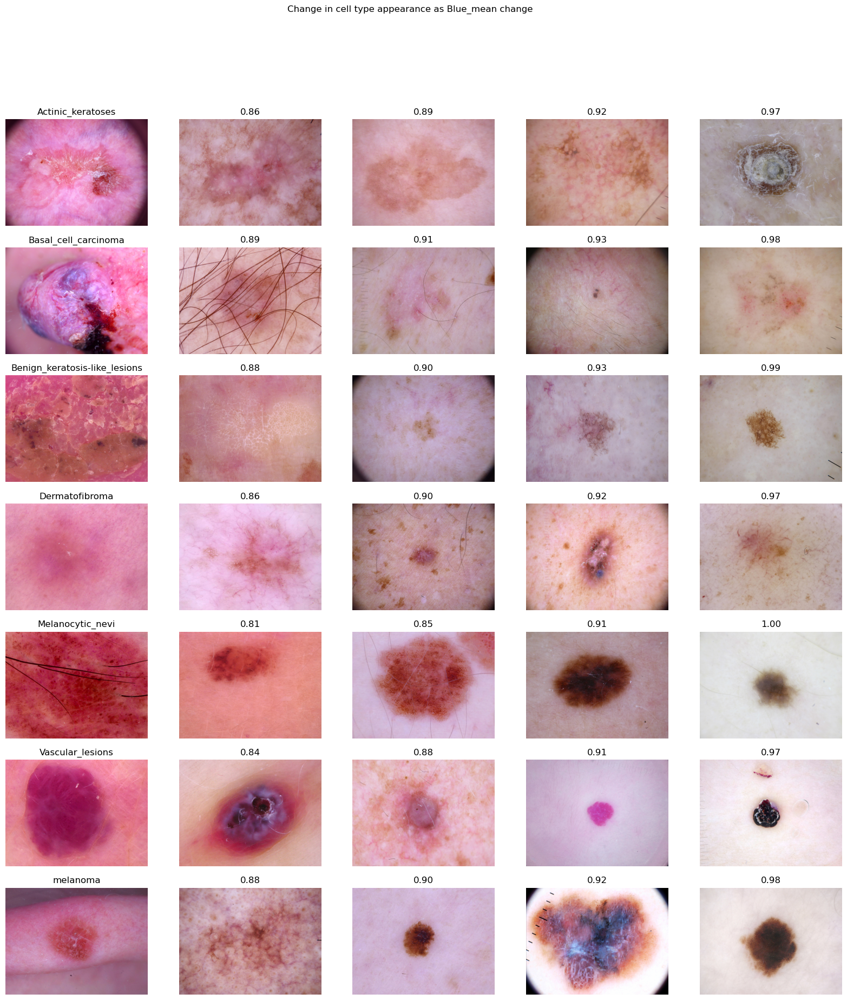

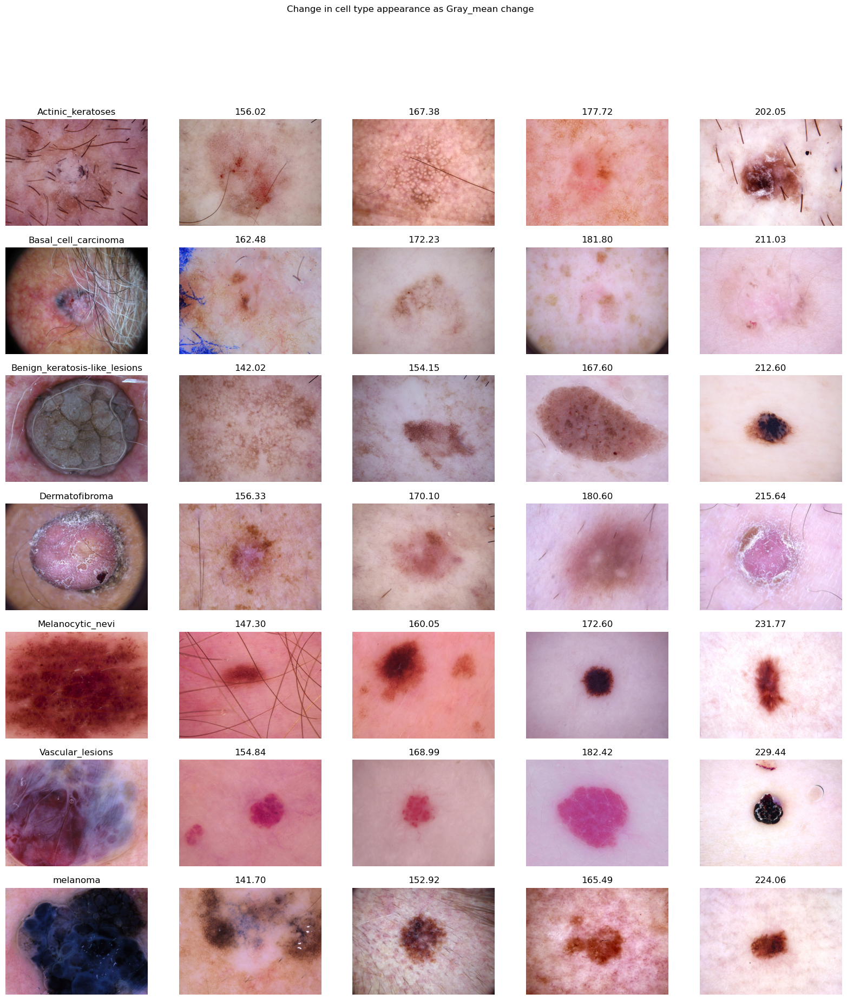

In [29]:
# Changes in cell type appearance as values in color chanel changes
n_samples = 5
for sample_col in ["Red_mean", "Green_mean", "Blue_mean", "Gray_mean"]:
    fig, m_axs = plt.subplots(7, n_samples, figsize=(4 * n_samples, 3 * 7))
    fig.suptitle(f"Change in cell type appearance as {sample_col} change")
    # define a function to get back a dataframe with 5 samples sorted by color channel values 
    def take_n_space(in_rows, val_col, n):
        s_rows = in_rows.sort_values([val_col])
        s_idx = np.linspace(0, s_rows.shape[0] - 1, n, dtype=int)
        return s_rows.iloc[s_idx]
    
    for n_axs, (type_name, type_rows) in zip(m_axs, skin_df.sort_values(["cell_type"]).groupby("cell_type")):
        for c_ax, (_, c_row) in zip(n_axs, take_n_space(type_rows, sample_col, n_samples).iterrows()):
            c_ax.imshow(c_row["image"])
            c_ax.axis("off")
            c_ax.set_title('{:2.2f}'.format(c_row[sample_col]))
        n_axs[0].set_title(type_name)
    fig.savefig("{}_samples.png".format(sample_col), dpi=300)

In [30]:
# Reshape image and get data for classification
from PIL import Image

In [ ]:
reshaped_image = skin_df["path"].map(lambda x: np.asarray(Image.open(x).resize((64,64), resample=Image.LANCZOS).\
                                                          convert("RGB")).ravel())

In [ ]:
out_vec = np.stack(reshaped_image, 0)

In [ ]:
out_df = pd.DataFrame(out_vec)

In [ ]:
out_df["label"] = skin_df["cell_type_idx"]

In [ ]:
out_df.head()

In [ ]:
out_path = "hmnist_64_64_RBG.csv"
out_df.to_csv(out_path, index=False)

In [ ]:
# Resize Image for Retraining Model
img = Image.open(skin_df["path"][0])
img.size

In [ ]:
!mkdir skin_lesion_types

In [ ]:
skin_df["cell_type"].unique()

In [ ]:
skin_df["path"][0]

In [ ]:
import os
from PIL import Image

base_dir = "C:/Users/dell6/OneDrive/Desktop/CODING_NEW/FACULTY PROJECT/skin_lesion_types"  # Updated base directory

for index in skin_df.index.values.tolist():
    path = skin_df.iloc[index]["path"]
    img_id = skin_df.iloc[index]["image_id"]
    cell_type_idx = skin_df.iloc[index]["cell_type"]

    newpath = os.path.join(base_dir, f"{img_id} {cell_type_idx}.jpg")  # Use os.path.join for reliable path construction

    try:
        img = Image.open(path)
        img = img.resize((299, 299), resample=Image.LANCZOS)
        img.save(newpath)
    except FileNotFoundError as e:
        print(f"Error processing image: {img_id}. Reason: {e}")


In [ ]:

for index in skin_df.index.values.tolist():
    path = skin_df.iloc[index]["path"]
    cell_type_idx = skin_df.iloc[index]["cell_type"]
    img_id = skin_df.iloc[index]["image_id"]
    newpath = f"C:/Users/dell6/OneDrive/Desktop/CODING_NEW/FACULTY PROJECT/skin_lesion_types/{cell_type_idx}.jpg"
    img = Image.open(path)
    img = img.resize((299, 299), resample=Image.LANCZOS)
    img.save(newpath)

In [ ]:
# Resize Image for Keras Fine-Tuning Model
reshaped_image = skin_df["path"].map(lambda x: np.asarray(Image.open(x).resize((256,192), resample=Image.LANCZOS).\
                                                          convert("RGB")))

In [ ]:
out_vec = np.stack(reshaped_image, 0)

In [ ]:
out_vec.shape

In [ ]:
out_vec = out_vec.astype("float16")
out_vec /= 255

In [ ]:
labels = skin_df["cell_type_idx"].values

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train_orig, X_test, y_train_orig, y_test = train_test_split(out_vec, labels, test_size=0.49,random_state=0)

In [ ]:
np.save("256_192_test.npy", X_test)
np.save("test_labels.npy", y_test)

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_train_orig, y_train_orig, test_size=0.1, random_state=1)

In [ ]:
np.save("256_192_val.npy", X_val)
np.save("val_labels.npy", y_val)

In [ ]:
np.save("256_192_train.npy", X_train)
np.save("train_labels.npy", y_train)